# GAN Explorations

-- Steven Larsen, Nick Larsen

In [ ]:
import numpy as np
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data

import torch.nn.functional as F

import torchvision
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import torch.autograd as autograd
from torch.autograd import Variable

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from torchvision.utils import save_image

#import torchgan

# Seed control, for better reproducibility 
# NOTE: this does not gurantee results are always the same
seed = 22
random.seed(seed)
np.random.seed(seed)
torch.manual_seed(seed)


if torch.cuda.is_available():
    device = torch.device("cuda:0")
    # work on a single GPU or CPU
    cudnn.benchmark=True
    #generator.cuda()
    #discriminator.cuda()
    #adversarial_loss.cuda()
    Tensor = torch.cuda.FloatTensor
    print(device)
else:
    device = torch.device("cpu")
    cudnn.benchmark=False
    Tensor = torch.FloatTensor


In [ ]:
def norm_grid(im):
    # first half should be normalized and second half also, separately
    im = im.astype(np.float)
    rows,cols,chan = im.shape
    cols_over2 = int(cols/2)
    tmp = im[:,:cols_over2,:]
    im[:,:cols_over2,:] = (tmp-tmp.min())/(tmp.max()-tmp.min())
    tmp = im[:,cols_over2:,:]
    im[:,cols_over2:,:] = (tmp-tmp.min())/(tmp.max()-tmp.min())
    return im

In [ ]:
from PIL import Image
from matplotlib import image
from matplotlib import pyplot

In [ ]:
from matplotlib import image
from matplotlib import pyplot

We are going to save off the images in the 64x64 format so we don't have to do that in the future

In [ ]:
dataroot = "./data/celeba_smaller/"
if True:
    workers = 32

    batch_size = 128

    image_size = 64

    nc = 3

    nz = 100

    dataset = dset.ImageFolder(root=dataroot,
                               transform=transforms.Compose([
                                   transforms.Resize(image_size),
                                   transforms.CenterCrop(image_size),
                                   transforms.ToTensor(),
                                   transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),]))

#    img_num = 1
#    path="data/celeba_small/img_align_celeba/"
#
#    for i, (imgs, classes) in enumerate(dataloader):
#        for img in imgs:
#            save_image(img,  f"{path}{img_num:06}.jpg")
#            img_num += 1
#            if img_num % 100 == 0: print(f"save {img_num} images")
#
#        if img_num > 100000:
#            breakns
#

In [ ]:
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=1)

In [ ]:
%%time
dataiter = iter(dataloader)
real_image_examples, classes = dataiter.next()

In [61]:
real_image_examples.shape

torch.Size([128, 3, 64, 64])

In [63]:
len(dataloader)*17.9/60

59.07

In [11]:
def imshow(img):
    # custom show in order to display
    # torch tensors as numpy
    npimg = img.numpy() / 2 + 0.5 # from tensor to numpy
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.axis('off')
    plt.show()


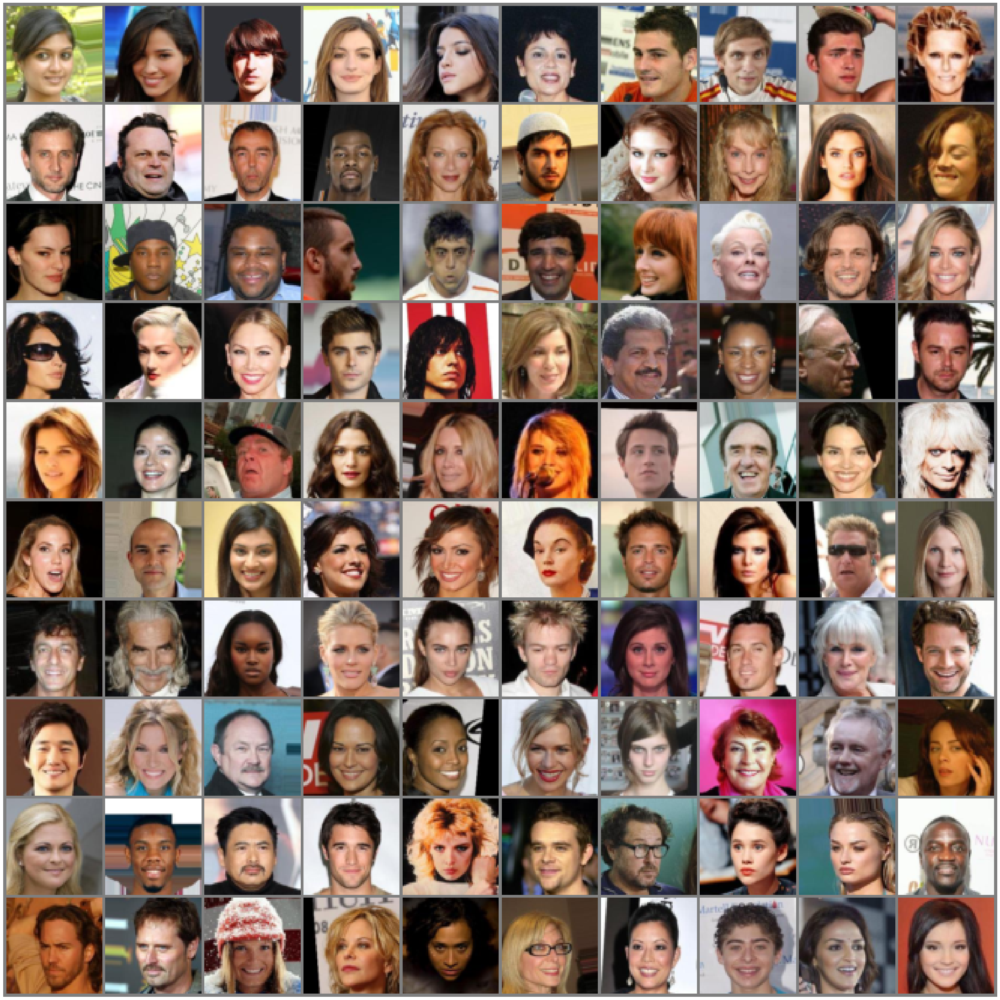

In [12]:
plt.figure(figsize=(40,40))
imshow(torchvision.utils.make_grid(real_image_examples[0:100], padding=2, normalize=False, nrow=10).cpu())

In [13]:
len(dataloader)

198

In [14]:
latent_dim = 100
height = real_image_examples[0].shape[1]
width = real_image_examples[0].shape[2]
channels = real_image_examples[0].shape[0]


In [15]:
class Generator(nn.Module):
    def __init__(self, latent_dim):
        super(Generator, self).__init__()
        
        # First, transform the input into a 8x8 256-channels feature map
        self.init_size = width // 16  # one 16th the image size 
        self._latent_dim = latent_dim
        self.l1 = nn.Sequential(
            nn.Linear(self._latent_dim, 64), nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(64, 128), nn.LeakyReLU(0.2, inplace=True),
            nn.Linear(128, 256 * self.init_size ** 2), nn.LeakyReLU(0.2, inplace=True), # 4X4
        )
        
        self.conv_blocks = nn.Sequential(
            #input 256 X init_size X init_size
            
            ############# 4x4 #########################################
            
            nn.BatchNorm2d(256), 
            nn.ConvTranspose2d(256, 128, 4, stride=2, padding=1), #8X8
            nn.LeakyReLU(0.2, inplace=True),
            
            ############# 8X8 #########################################
            
            nn.BatchNorm2d(128), 
            nn.ConvTranspose2d(128, 64, 4, stride=2, padding=1), #16X16
            nn.LeakyReLU(0.2, inplace=True),
            
            ############# 16X16 #########################################
            
            nn.BatchNorm2d(64), 
            nn.ConvTranspose2d(64, 32, 4, stride=2, padding=1), #32X32
            nn.LeakyReLU(0.2, inplace=True),
            
            ############# 32X32 #########################################
            
            nn.BatchNorm2d(32), 
            nn.ConvTranspose2d(32, 16, 4, stride=2, padding=1), #64X64
            nn.LeakyReLU(0.2, inplace=True),
            
            ############# 64X64 #########################################
            
            # Produce a 32x32xRGB-channel feature map
            nn.Conv2d(16, channels, kernel_size=3, padding='same'),
            nn.Tanh(),
        )
        
    def forward(self, z):
        
        # expand the sampled z to 8x8
        out = self.l1(z)
        
        out = torch.reshape(out, (out.shape[0], 256, self.init_size, self.init_size))
        
        # use the view function to reshape the layer output
        #  old way for earlier Torch versions: out = out.view(out.shape[0], 128, self.init_size, self.init_size)
        img = self.conv_blocks(out)
        return img

In [16]:
%time
gen = Generator(latent_dim).to(device)

CPU times: user 1e+03 ns, sys: 2 µs, total: 3 µs
Wall time: 5.72 µs


In [17]:
random_latent_vectors = Variable(Tensor(np.random.normal(0, 1, (32, latent_dim))))
generated_images = gen(random_latent_vectors)

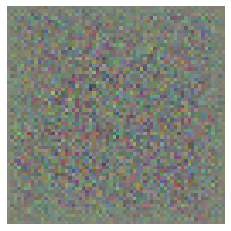

In [18]:
imshow(generated_images[1].detach().cpu())

In [19]:
class Discriminator(nn.Module):

    def __init__(self, latent_dim):
        super(Discriminator, self).__init__()
        
        self.init_size = width // 16 # one 16th the image size 
        self._latent_dim = latent_dim

        self.model = nn.Sequential(
            
            ############# 64X64 #########################################
            nn.Conv2d(in_channels=3, out_channels=16, kernel_size=3, stride=1, padding='same'), #64X64
            nn.LeakyReLU(0.2, inplace=True),
            nn.BatchNorm2d(16, 0.8),
            
            nn.Conv2d(in_channels=16, out_channels=32, kernel_size=4, stride=2, padding=1), #32X32
            nn.LeakyReLU(0.2, inplace=True),
            nn.BatchNorm2d(32, 0.8),
            
            ############# 32X32 #########################################
            
            nn.Conv2d(in_channels=32, out_channels=64, kernel_size=4, stride=2, padding=1), #16X16
            nn.LeakyReLU(0.2, inplace=True),
            nn.BatchNorm2d(64, 0.8),
            
            ############# 16X16 #########################################
            
            nn.Conv2d(in_channels=64, out_channels=128, kernel_size=4, stride=2, padding=1), #8x8
            nn.LeakyReLU(0.2, inplace=True),
            nn.BatchNorm2d(128, 0.8),
            
            ############# 8X8 #########################################
            
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=4, stride=2, padding=1), #4X4
            nn.LeakyReLU(0.2, inplace=True),
            nn.BatchNorm2d(256, 0.8),
            
            ############# 4x4 #########################################
            
            nn.Conv2d(in_channels=256, out_channels=256, kernel_size=3, stride=1, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.BatchNorm2d(256, 0.8),
        )
        
        # laten_dim_layer layer
        self.laten_dim_layer = nn.Sequential(nn.Linear(256 * self.init_size ** 2, 128), nn.LeakyReLU(0.2, inplace=True),
                                             nn.Linear(128, 64), nn.LeakyReLU(0.2, inplace=True),
                                             nn.Linear(64, self._latent_dim), nn.LeakyReLU(0.2, inplace=True),
                                            )
        # Classification layer
        self.classification_layer = nn.Sequential(nn.Linear(self._latent_dim, 1), 
                                                  nn.Sigmoid())
    def forward(self, img):
        
        out = self.model(img)
        # use the view function to flatten the layer output
        #    old way for earlier Torch versions: out = out.view(out.shape[0], -1)
        out = torch.flatten(out, start_dim=1) # don't flatten over batch size
        
        # move to the latent dim
        out = self.laten_dim_layer(out)
        
        #validate the latent dim
        validity = self.classification_layer(out)
        return validity


In [20]:
disc = Discriminator(latent_dim).to(device)

In [21]:
disc(generated_images)

tensor([[0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698],
        [0.4698]], device='cuda:0', grad_fn=<SigmoidBackward0>)

In [22]:
# custom weights initialization called on netG and netD
# this function from PyTorch's officail DCGAN example:
# https://github.com/pytorch/examples/blob/master/dcgan/main.py#L112
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02) # filters are zero mean, small STDev
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02) # batch norm is unit mean, small STDev
        m.bias.data.fill_(0) # like normal, biases start at zero

In [23]:
batch_size

128

In [24]:
log_every = 5
save_off_every = 10


# code is the exact same as above, no need to change it
# because we have changed the adversarial loss function
# Start training loop

# Becasue not much is changing, an interesting update would
# be to write a "train step" function and use it here.
# Something like: train_step(g, d, imgs, loss_select=MSE, num_d_steps=1)

def train(generator, gan_optimizer,
          discriminator, discriminator_optimizer,
          iterations, dataloader, begin_step=None
          
    ):
    total_steps = 0
    if begin_step is not None:
        total_steps = begin_step

    for step in range(iterations):
        total_steps = total_steps+1

        for i, (imgs, classes) in enumerate(dataloader):
            #===================================
            # GENERATOR OPTIMIZE AND GET LABELS

            # Zero out any previous calculated gradients
            gan_optimizer.zero_grad()

            # Sample random points in the latent space
            random_latent_vectors = Variable(Tensor(np.random.normal(0, 1, (imgs.shape[0], latent_dim))))
            # Decode them to fake images, through the generator
            generated_images = generator(random_latent_vectors)

            # Assemble labels that say "all real images"
            # misleading target, c=1
            misleading_targets = Variable(Tensor(imgs.shape[0], 1).fill_(1.0), requires_grad=False)

            # Get MSE Loss function
            # want generator output to generate images that are "close" to all "ones" 
            g_loss = adversarial_loss(discriminator(generated_images), misleading_targets)

            # now back propagate to get derivatives
            g_loss.backward()

            # use gan optimizer to only update the parameters of the generator
            # this was setup above to only use the params of generator
            gan_optimizer.step()

            #===================================
            # DISCRIMINATOR OPTIMIZE AND GET LABELS

            # Zero out any previous calculated gradients
            discriminator_optimizer.zero_grad()

            # Combine real images with some generator images
            real_images = Variable(imgs.type(Tensor))
            combined_images = torch.cat([real_images, generated_images.detach()])
            # in the above line, we "detach" the generated images from the generator
            # this is to ensure that no needless gradients are calculated 
            # those parameters wouldn't be updated (becasue we already defined the optimized parameters)
            # but they would be calculated here, which wastes time.

            # Assemble labels discriminating real from fake images
            # real label, a=1 and fake label, b=0
            labels = torch.cat((
                Variable(Tensor(imgs.shape[0], 1).fill_(1.0), requires_grad=False),
                Variable(Tensor(imgs.shape[0], 1).fill_(0.0), requires_grad=False)
            ))
            # Add random noise to the labels - important trick!
            labels += 0.05 * torch.rand(labels.shape).to(device)

            # Setup Discriminator loss
            # this takes the average of MSE(real images labeled as real) + MSE(fake images labeled as fake)
            mid_point = combined_images.shape[0] // 2
            d_loss = (
                adversarial_loss(discriminator(combined_images[:mid_point]), labels[:mid_point]) + \
                adversarial_loss(discriminator(combined_images[mid_point:]), labels[mid_point:])
                ) / 2

            # get gradients according to loss above
            d_loss.backward()
            # optimize the discriminator parameters to better classify images
            discriminator_optimizer.step()

            # Now Clip weights of discriminator (manually)
            for p in discriminator.parameters():
                p.data.clamp_(-clip_value, clip_value)

            #===================================
        
        # Occasionally save / plot
        if step % log_every == 0:
            # Print metrics
            print('Loss at step %s: D(z_c)=%s, D(G(z_mis))=%s' % (total_steps, d_loss.item(),g_loss.item()))
            # save images in a list for display later
        
        if step % save_off_every == 0:
            
            with torch.no_grad():
                fake_output = generator(fixed_random_latent_vectors).detach().cpu()
            img_list.append(torchvision.utils.make_grid(fake_output, padding=2, normalize=True, nrow=5))

            # in addition, save off a checkpoint of the current models and images
            ims = np.array([np.transpose(np.hstack((i,real_image_numpy)), (2,1,0)) for i in img_list])
            np.save('models/gan_models/ls_images_celeb.npy',ims)

            # save the state of the models (will need to recreate upon reloading)
            torch.save({'state_dict': generator.state_dict()}, 'models/gan_models/ls_gen_celeb.pth')
            torch.save({'state_dict': discriminator.state_dict()}, 'models/gan_models/ls_dis_celeb.pth')
    return (ims)

In [139]:
generator = Generator(latent_dim).to(device)
discriminator = Discriminator(latent_dim).to(device)

# LSGAN says they use ADAM, but follow up papers say RMSProp is lsightly better
#lr = 0.0002
#betas = (0.5, 0.999)

# To stabilize training, we use learning rate decay
# and gradient clipping (by value) in the optimizer.
clip_value = 1.0 # This value will use in the future training process since 
                 # PyTorch didn't has the feature to set clipvalue for 
                 # RMSprop optimizer.
        
# set discriminator learning higher than generator
discriminator_optimizer = torch.optim.RMSprop(discriminator.parameters(),
                                              lr=0.0002, weight_decay=1e-8)

gan_optimizer = torch.optim.RMSprop(generator.parameters(),
                                    lr=0.0001, weight_decay=1e-8)

# used to be: adversarial_loss = torch.nn.BCELoss() # binary cross entropy 
adversarial_loss = torch.nn.MSELoss() # mean squared error loss 

generator.apply(weights_init)
discriminator.apply(weights_init)

Discriminator(
  (model): Sequential(
    (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): BatchNorm2d(16, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (3): Conv2d(16, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): BatchNorm2d(32, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (6): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): BatchNorm2d(64, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (9): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): BatchNorm2d(128, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (12): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (13): LeakyReLU(neg

In [ ]:
%%time
"""
Train the Vanilla GAN. Here we use the train method above and plot each class seperately
"""
iterations = 600



# Sample random points in the latent space
plot_num_examples = 25
fixed_random_latent_vectors = torch.randn(plot_num_examples, latent_dim, device=device)
img_list= []
total_steps = 0

real_image_numpy = np.transpose(
    torchvision.utils.make_grid(real_image_examples[:plot_num_examples,:,:,:],
                                padding=2, normalize=False, nrow=5),(0,1,2))

ims = train(generator=generator, gan_optimizer=gan_optimizer,
                         discriminator=discriminator, discriminator_optimizer=discriminator_optimizer,
                         iterations=iterations, dataloader=dataloader
                         )

Loss at step 1: D(z_c)=0.08282089978456497, D(G(z_mis))=0.8825749158859253
Loss at step 6: D(z_c)=0.16340582072734833, D(G(z_mis))=0.2706459164619446
Loss at step 11: D(z_c)=0.13464991748332977, D(G(z_mis))=0.6709614992141724
Loss at step 16: D(z_c)=0.10475669056177139, D(G(z_mis))=0.8939282298088074
Loss at step 21: D(z_c)=0.10017567873001099, D(G(z_mis))=0.4245537519454956
Loss at step 26: D(z_c)=0.2296193242073059, D(G(z_mis))=0.9832988977432251
Loss at step 31: D(z_c)=0.04260001331567764, D(G(z_mis))=0.6673021912574768
Loss at step 36: D(z_c)=0.0029741348698735237, D(G(z_mis))=0.9023066163063049
Loss at step 41: D(z_c)=0.03512044623494148, D(G(z_mis))=0.6937226057052612
Loss at step 46: D(z_c)=0.002007504692301154, D(G(z_mis))=0.9315057992935181
Loss at step 51: D(z_c)=0.03747028857469559, D(G(z_mis))=0.6738606095314026
Loss at step 56: D(z_c)=0.022661659866571426, D(G(z_mis))=0.7633219361305237
Loss at step 61: D(z_c)=0.009184280410408974, D(G(z_mis))=0.8646715879440308
Loss at st

In [26]:
def load_checkpoint(file_prefix, gen_func, disc_func):
    # load up checkpoint images from previous runs ls_images_dog.npy
    ims = np.load(f'models/gan_models/{file_prefix}_images_celeb.npy')

    generator = gen_func(100) # create generator (no weights)
    discriminator = disc_func(100) # create disciminator (no weights)

    # now populate the weights from a previous training
    print(f'models/gan_models/{file_prefix}_gen.pth')
    checkpoint = torch.load(f'models/gan_models/{file_prefix}_gen_celeb.pth')
    generator.load_state_dict(checkpoint['state_dict'])

    checkpoint = torch.load(f'models/gan_models/{file_prefix}_dis_celeb.pth')
    discriminator.load_state_dict(checkpoint['state_dict'])
    
    return ims, generator, discriminator

In [27]:
if True:
    ims, generator, discriminator= load_checkpoint('ls', Generator, Discriminator)

models/gan_models/ls_gen.pth


/users/nlarsen/.conda/envs/torch_gpu/lib/python3.7/site-packages/ipykernel_launcher.py:3: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  This is separate from the ipykernel package so we can avoid doing imports until


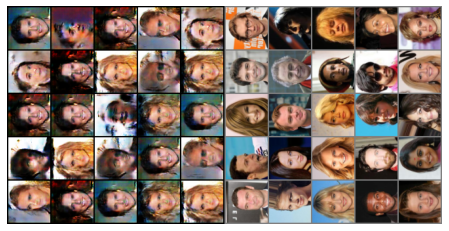

In [28]:
fig = plt.figure(figsize=(12,4))
plt.axis("off")  
pls = [[plt.imshow(norm_grid(im), animated=True)] for im in ims]
ani = animation.ArtistAnimation(fig, pls, interval=500, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

In [27]:
# Plot a lot of generated images

# Sample random points in the latent space
random_latent_vectors = Variable(Tensor(np.random.normal(0, 1, (100, latent_dim)))).to(device)
# Decode them to fake images, through the generator
generator.to(device)
generated_images = generator(random_latent_vectors)

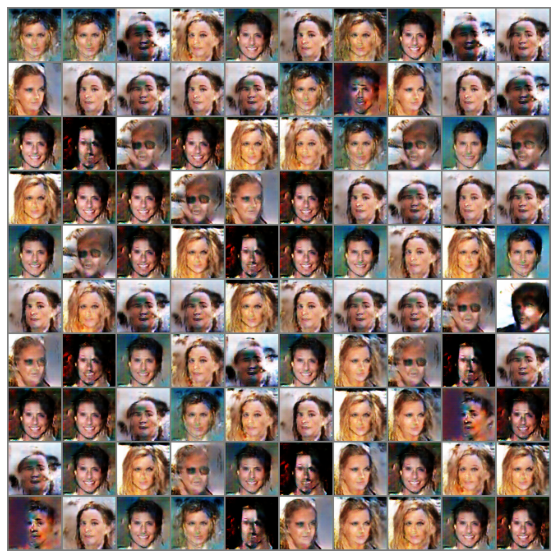

In [28]:
plt.figure(figsize=(10,10))
imshow(torchvision.utils.make_grid(generated_images, padding=2, normalize=False, nrow=10).cpu())

# Use disc weight reset
The idea here is simple. Every certian number of epochs set the weights of the discriminator back some amount. This may give the generator an edge in training cause the discrinimator will "forget" things it learned about the generator.

In [36]:

def train_setback(set_back_frequency,
                  set_back_percentage,
                  iterations):
    
    total_steps = 0
    setback_amount = int(set_back_percentage*set_back_frequency)

    for step in range(iterations):
        total_steps = total_steps+1
        
        # Check if it is time to save off weights for future
        if (total_steps+setback_amount) % set_back_frequency == 0:
            print(f"saving weights at {total_steps}")
        
        
        # Check if it is time to load the saved off weights
        if total_steps % set_back_frequency == 0:
            print(f"set back at {total_steps}")
            
            
train_setback(100, .3, 600)

saving weights at 70
set back at 100
saving weights at 170
set back at 200
saving weights at 270
set back at 300
saving weights at 370
set back at 400
saving weights at 470
set back at 500
saving weights at 570
set back at 600


In [56]:
log_every = 5
save_off_every = 10


# code is the exact same as above, no need to change it
# because we have changed the adversarial loss function
# Start training loop

# Becasue not much is changing, an interesting update would
# be to write a "train step" function and use it here.
# Something like: train_step(g, d, imgs, loss_select=MSE, num_d_steps=1)

def train_setback(generator, gan_optimizer,
          discriminator, discriminator_optimizer,
          iterations, dataloader, 
          setback_frequency=None,
          setback_percentage=None,
          begin_step=None):
    
    setback_amount = int(setback_percentage*setback_frequency)
    
    total_steps = 0
    if begin_step is not None:
        total_steps = begin_step

    for step in range(iterations):
        total_steps = total_steps+1

        for i, (imgs, classes) in enumerate(dataloader):
            print(f"batch {i}")
            #===================================
            # GENERATOR OPTIMIZE AND GET LABELS

            # Zero out any previous calculated gradients
            gan_optimizer.zero_grad()

            # Sample random points in the latent space
            random_latent_vectors = Variable(Tensor(np.random.normal(0, 1, (imgs.shape[0], latent_dim))))
            # Decode them to fake images, through the generator
            generated_images = generator(random_latent_vectors)

            # Assemble labels that say "all real images"
            # misleading target, c=1
            misleading_targets = Variable(Tensor(imgs.shape[0], 1).fill_(1.0), requires_grad=False)

            # Get MSE Loss function
            # want generator output to generate images that are "close" to all "ones" 
            g_loss = adversarial_loss(discriminator(generated_images), misleading_targets)

            # now back propagate to get derivatives
            g_loss.backward()

            # use gan optimizer to only update the parameters of the generator
            # this was setup above to only use the params of generator
            gan_optimizer.step()

            #===================================
            # DISCRIMINATOR OPTIMIZE AND GET LABELS
            
            if setback_frequency is not None and setback_percentage is not None:
                # Check if we need to save off the weights
                if (total_steps+setback_amount) % setback_frequency == 0:
                    print(f"save off weights at {total_steps}")
                    torch.save({'state_dict': discriminator.state_dict()}, 'models/gan_models/setback_dis_temp.pth')
                # Check if we need to load in the weights
                if total_steps % setback_frequency == 0:
                    print(f"set back at {total_steps}")
                    checkpoint = torch.load('models/gan_models/setback_dis_temp.pth')
                    discriminator.load_state_dict(checkpoint['state_dict'])

            # Zero out any previous calculated gradients
            discriminator_optimizer.zero_grad()

            # Combine real images with some generator images
            real_images = Variable(imgs.type(Tensor))
            combined_images = torch.cat([real_images, generated_images.detach()])
            # in the above line, we "detach" the generated images from the generator
            # this is to ensure that no needless gradients are calculated 
            # those parameters wouldn't be updated (becasue we already defined the optimized parameters)
            # but they would be calculated here, which wastes time.

            # Assemble labels discriminating real from fake images
            # real label, a=1 and fake label, b=0
            labels = torch.cat((
                Variable(Tensor(imgs.shape[0], 1).fill_(1.0), requires_grad=False),
                Variable(Tensor(imgs.shape[0], 1).fill_(0.0), requires_grad=False)
            ))
            # Add random noise to the labels - important trick!
            labels += 0.05 * torch.rand(labels.shape).to(device)

            # Setup Discriminator loss
            # this takes the average of MSE(real images labeled as real) + MSE(fake images labeled as fake)
            mid_point = combined_images.shape[0] // 2
            d_loss = (
                adversarial_loss(discriminator(combined_images[:mid_point]), labels[:mid_point]) + \
                adversarial_loss(discriminator(combined_images[mid_point:]), labels[mid_point:])
                ) / 2

            # get gradients according to loss above
            d_loss.backward()
            # optimize the discriminator parameters to better classify images
            discriminator_optimizer.step()

            # Now Clip weights of discriminator (manually)
            for p in discriminator.parameters():
                p.data.clamp_(-clip_value, clip_value)

            #===================================
        
        # Occasionally save / plot
        if step % log_every == 0:
            # Print metrics
            print('Loss at step %s: D(z_c)=%s, D(G(z_mis))=%s' % (total_steps, d_loss.item(),g_loss.item()))
            # save images in a list for display later
        
        if step % save_off_every == 0:
            
            with torch.no_grad():
                fake_output = generator(fixed_random_latent_vectors).detach().cpu()
            img_list.append(torchvision.utils.make_grid(fake_output, padding=2, normalize=True, nrow=5))

            # in addition, save off a checkpoint of the current models and images
            ims = np.array([np.transpose(np.hstack((i,real_image_numpy)), (2,1,0)) for i in img_list])
            np.save('models/gan_models/setback_images_celeb.npy',ims)

            # save the state of the models (will need to recreate upon reloading)
            torch.save({'state_dict': generator.state_dict()}, 'models/gan_models/setback_gen_celeb.pth')
            torch.save({'state_dict': discriminator.state_dict()}, 'models/gan_models/setback_dis_celeb.pth')
    return (ims)

In [57]:
generator = Generator(latent_dim).to(device)
discriminator = Discriminator(latent_dim).to(device)

# LSGAN says they use ADAM, but follow up papers say RMSProp is lsightly better
#lr = 0.0002
#betas = (0.5, 0.999)

# To stabilize training, we use learning rate decay
# and gradient clipping (by value) in the optimizer.
clip_value = 1.0 # This value will use in the future training process since 
                 # PyTorch didn't has the feature to set clipvalue for 
                 # RMSprop optimizer.
        
# set discriminator learning higher than generator
discriminator_optimizer = torch.optim.RMSprop(discriminator.parameters(),
                                              lr=0.0002, weight_decay=1e-8)

gan_optimizer = torch.optim.RMSprop(generator.parameters(),
                                    lr=0.0001, weight_decay=1e-8)

# used to be: adversarial_loss = torch.nn.BCELoss() # binary cross entropy 
adversarial_loss = torch.nn.MSELoss() # mean squared error loss 

generator.apply(weights_init)
discriminator.apply(weights_init)

Discriminator(
  (model): Sequential(
    (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=same)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): BatchNorm2d(16, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (3): Conv2d(16, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): BatchNorm2d(32, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (6): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): BatchNorm2d(64, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (9): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): BatchNorm2d(128, eps=0.8, momentum=0.1, affine=True, track_running_stats=True)
    (12): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (13): LeakyReLU(neg

In [58]:
%%time
"""
Train the Vanilla GAN. Here we use the train method above and plot each class seperately
"""
iterations = 21



# Sample random points in the latent space
plot_num_examples = 25
fixed_random_latent_vectors = torch.randn(plot_num_examples, latent_dim, device=device)
img_list= []
total_steps = 0

real_image_numpy = np.transpose(
    torchvision.utils.make_grid(real_image_examples[:plot_num_examples,:,:,:],
                                padding=2, normalize=False, nrow=5),(0,1,2))

ims = train_setback(generator=generator, gan_optimizer=gan_optimizer,
                    discriminator=discriminator, discriminator_optimizer=discriminator_optimizer,
                    iterations=iterations, dataloader=dataloader,
                    setback_frequency=10,setback_percentage=.5
                         )

batch 0
batch 1


KeyboardInterrupt: 